In [1]:
%load_ext autoreload
%autoreload 2


import scanpy as sc
import seaborn as sns
import pandas as pd
from scipy.stats import median_abs_deviation
import numpy as np
import matplotlib.pyplot as plt
import scrublet as scr
from tqdm.notebook import tqdm

from utils import preprocessing

# Hyperparamyters
LIBRARY = "H3"


# Goals

- QC metrics
- Plot cell type annotaions

# Load Adata

In [2]:
ADATA_PATH = f'/home/gdallagl/myworkdir/XDP/data/XDP/disease/240805_SL-EXD_0328_B22FKKYLT4/SI-TT-{LIBRARY}/adata/labelled_adata.h5ad'
adata = sc.read_h5ad(ADATA_PATH)

print(adata)

AnnData object with n_obs × n_vars = 36649 × 38606
    obs: 'x', 'y', 'pct_intronic', 'is_cell', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Neighborhood_aggregate_probability', 'Neighborhood_correlation_coefficient', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Class_aggregate_probability', 'Class_correlation_coefficient', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Subclass_aggregate_probability', 'Subclass_correlation_coefficient', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Group_aggregate_probability', 'Group_correlation_coefficient', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'Cluster_aggregate_probability', 'Cluster_correlation_coefficient'
    var: 'feature_types', 'genome', 'gene_symbol'
    obsm: 'spatial'
    layers: 'counts'


# Calculate QC Metrics

In [3]:
# Calculate qc
adata.var["mt"] = adata.var.gene_symbol.str.startswith("MT-") # mitochondrial genes, ATTNETION: the names are in "gene_symbol"
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], inplace=True)

In [ ]:
# scrub = scr.Scrublet(adata.X, expected_doublet_rate=0.06)
#     # raw count matrix
#     # for single sample
# doublet_scores, predicted_doublets = scrub.scrub_doublets(
#     min_counts=2,
#     min_cells=3,
#     min_gene_variability_pctl=85,
#     n_prin_comps=30
# )

# adata.obs['doublet_score'] = doublet_scores
# adata.obs['predicted_doublet'] = predicted_doublets

# print(f"\nScrublet results:")
# print(f"  Predicted doublets: {predicted_doublets.sum()} ({100*predicted_doublets.sum()/len(adata):.1f}%)")
# print(f"  Mean doublet score: {doublet_scores.mean():.3f}")

# scrub.plot_histogram()

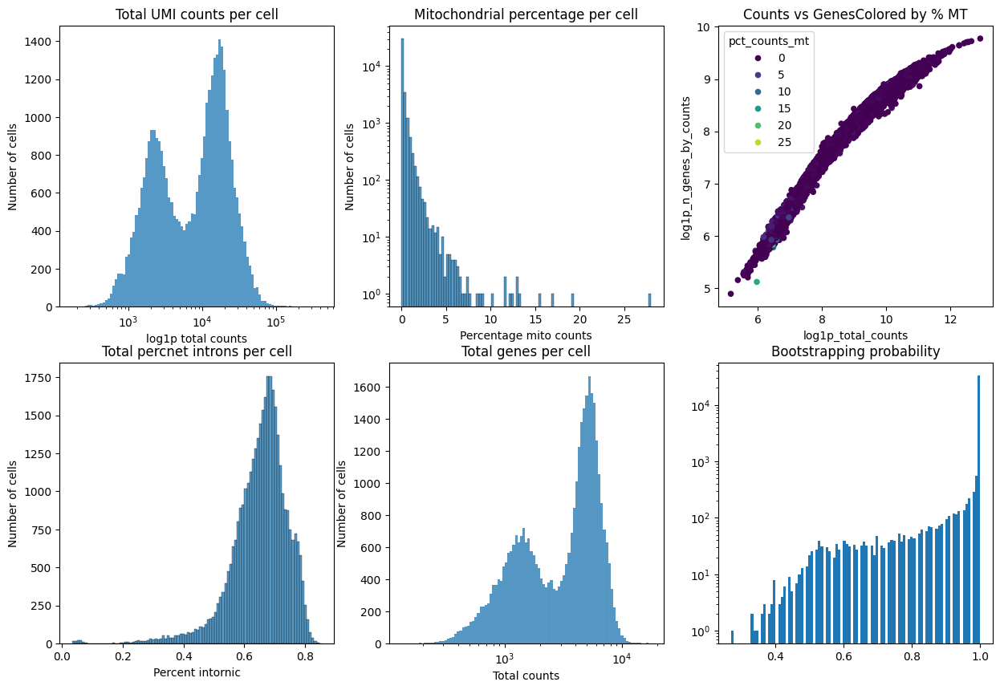

In [4]:
preprocessing.plot_qc_metrics(adata)

# Minimal Filter cells & genes

In [5]:
print(f"Starting: {adata.n_obs:,} cells\n")

# Calculate all filters (keep = pass filter)
filters = { # lists of boolen (True == to keep)
    
    'min_UMI': adata.obs["total_counts"] >= 4000,
    'min_genes': adata.obs["n_genes_by_counts"] >= 1400,
    'mt_threshold': adata.obs["pct_counts_mt"] <= 8,
    'is_cell_dropsift': adata.obs["is_cell"] == True,
    'percent_intronic_threshold': adata.obs["pct_intronic"] >= 0.2,
    'mapmycells_probs_class': (adata.obs['Class_bootstrapping_probability'] >= 0.5), # & (adata.obs['Class_correlation_coefficient'] >= 0.5),
    'spatial_present': ~adata.obs.x.isna(),
}

# Print individual filter stats
n_start = len(adata)
for name, filt in filters.items():
    removed = (~filt).sum()
    print(f"{name:30s}: {removed:6,} removed ({100*removed/len(adata):5.1f}%)")

# Replace adata
cells_to_keep = pd.DataFrame(filters).all(axis=1)  # AND
adata = adata[cells_to_keep].copy()

print(f"Final: {adata.n_obs:,} / {n_start:,} cells retained ({100*adata.n_obs/n_start:.1f}%)")

Starting: 36,649 cells

min_UMI                       : 13,239 removed ( 36.1%)
min_genes                     :  8,727 removed ( 23.8%)
mt_threshold                  :     15 removed (  0.0%)
is_cell_dropsift              :    877 removed (  2.4%)
percent_intronic_threshold    :    123 removed (  0.3%)
mapmycells_probs_class        :     94 removed (  0.3%)
spatial_present               :    609 removed (  1.7%)
Final: 23,125 / 36,649 cells retained (63.1%)


In [6]:
# Filter genes
print(f"   Genes before filtering: {adata.n_vars}")
sc.pp.filter_genes(adata, min_cells=3)
print(f"   Genes after filtering: {adata.n_vars}")

   Genes before filtering: 38606
   Genes after filtering: 33833


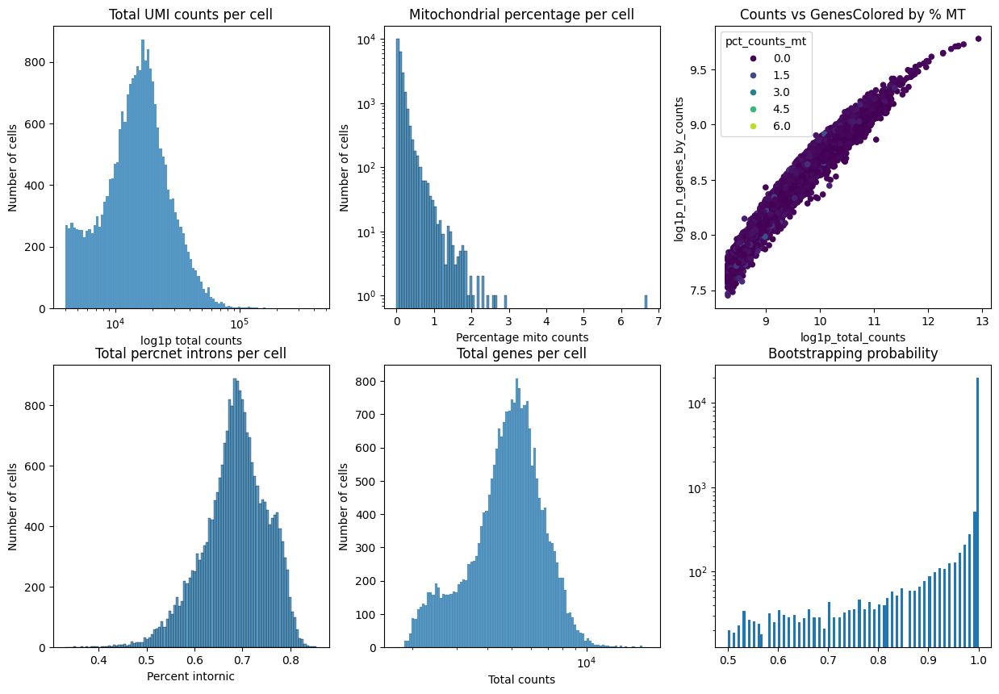

In [7]:
preprocessing.plot_qc_metrics(adata)

# Processing Pipeline

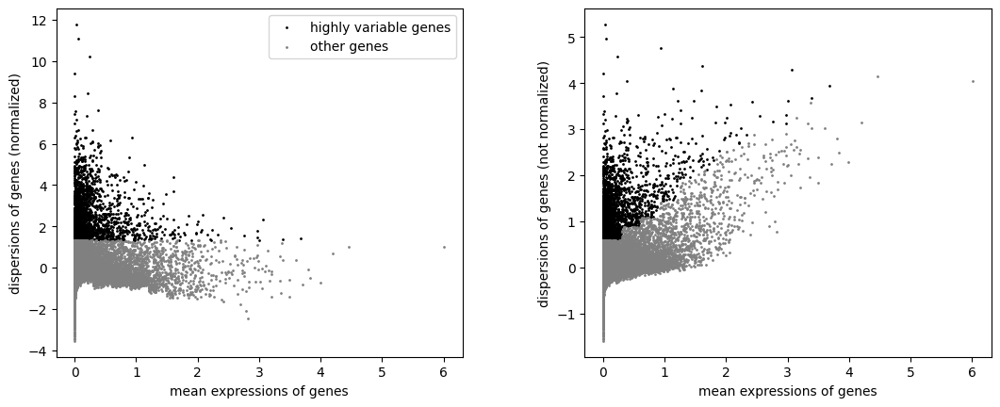

/home/gdallagl/.pyenv/versions/3.11.8/lib/python3.11/functools.py:909: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)


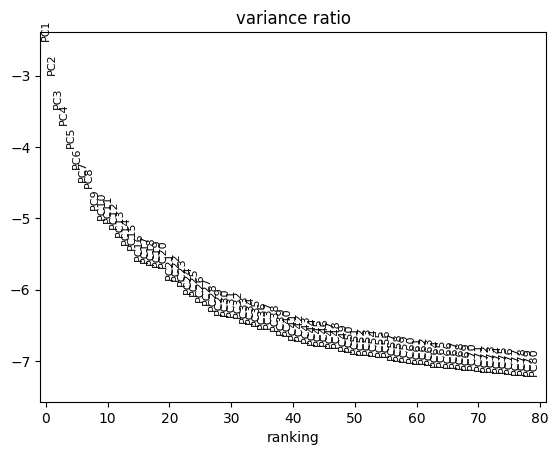

In [8]:
preprocessing.preprocess(adata, n_pcs_elbow=30, n_hvg=3000)

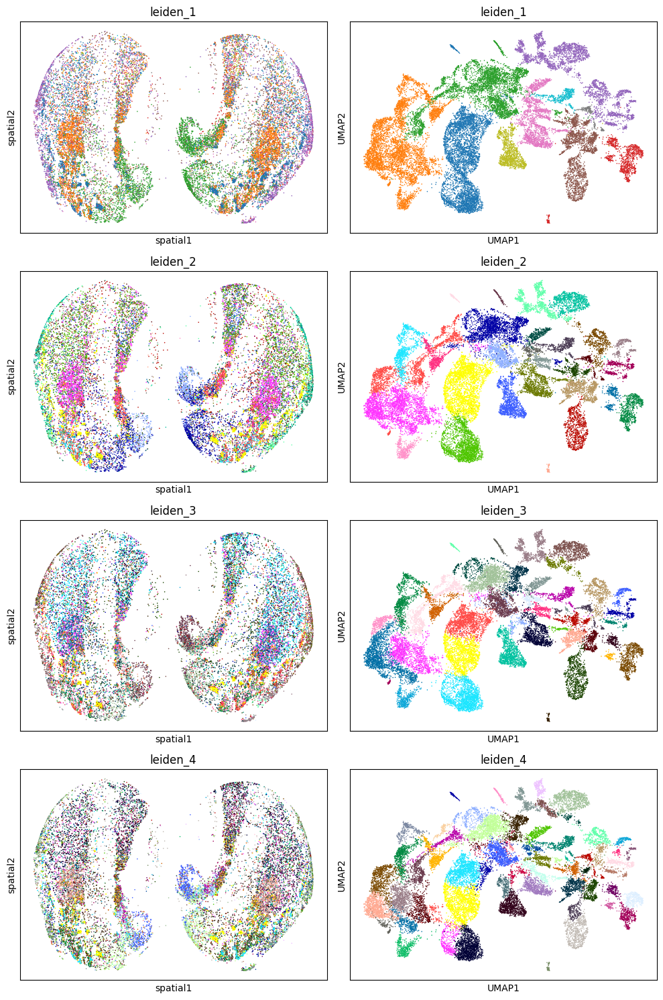

In [9]:
# Plor ledein clistering

fig, axes = plt.subplots(4, 2, figsize=(10, 15))

for i, res in enumerate(["leiden_1", "leiden_2", "leiden_3", "leiden_4"]):
    sc.pl.embedding(adata, basis="spatial", color=res, ax=axes[i,0], show=False, legend_loc=None)
    sc.pl.umap(adata, color=res, ax=axes[i,1], show=False, legend_loc=None)

plt.tight_layout()
plt.show()

# Investigate PCs

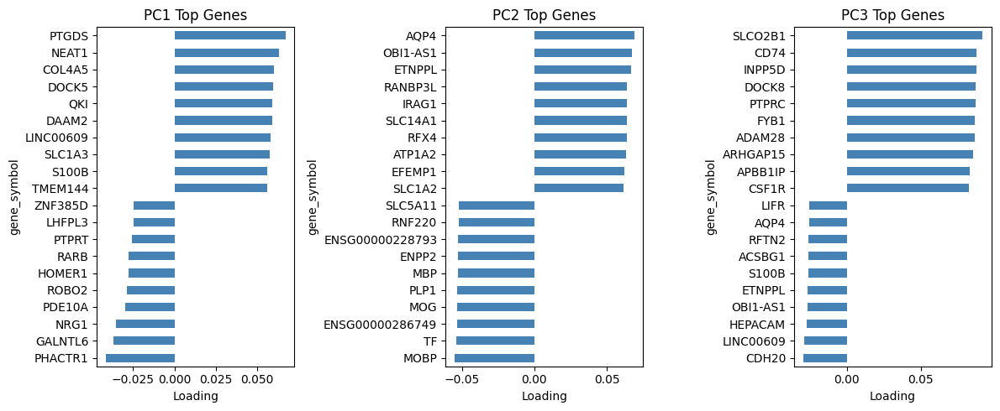

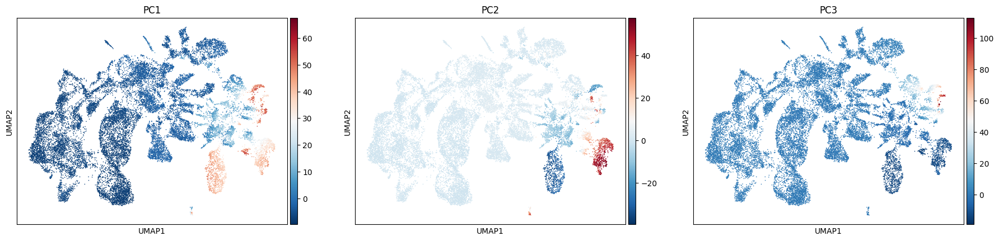

In [13]:
preprocessing.show_top_pc_genes(adata, n_pcs=3, top_n=10)

**PC1: Oligodendrocytes ↔ Neurons**

Positive (Neuronal):
  CELF2, ARHGAP26, KCNMA1, SLC8A1, NEBL
  → Neuronal genes (ion channels, synaptic)

Negative (Oligodendrocyte):
  PLP1 (-0.058) ← MAJOR myelin gene!
  APOD, LAMA2
  → Oligodendrocyte/myelin genes

**PC2: Astrocytes vs Oligodendrocytes**

Positive (Astrocytes):
AQP4, SLC1A2, ATP1A2, ETNPPL = Classic astrocyte markers

Negative (Oligodendrocytes):
MBP, MOG, MOBP, PLP1, TF = Myelin genes (oligodendrocytes)

**PC3: Microglia vs Astrocytes**

Positive (Microglia/Immune):
CD74, PTPRC (CD45), CSF1R, INPP5D = Microglia/immune cell markers

Negative (Astrocytes):
Same astrocyte genes from PC2
  → Canonical astrocyte markers

In [ ]:
# # Correlation of PC1 with QC metrics
# import scipy.stats as stats

# qc_metrics = ['total_counts', 'n_genes_by_counts', 'pct_counts_mt', 'pct_intronic']

# print("PC1 Correlation with QC Metrics:")
# for metric in qc_metrics:
#     corr, pval = stats.pearsonr(adata.obsm['X_pca'][:, 0], adata.obs[metric])
#     print(f"  {metric:25s}: r={corr:6.3f}, p={pval:.2e}")

# # If ANY correlation > 0.5 → PC1 is capturing technical noise! --> PC1 has moderate correlation with sequencing depth:

# # 2. Visualize
# fig, axes = plt.subplots(2, 2, figsize=(12, 10))
# axes = axes.flatten()

# for i, metric in enumerate(qc_metrics):
#     axes[i].scatter(
#         adata.obsm['X_pca'][:, 0], 
#         adata.obs[metric],
#         s=1, alpha=0.3
#     )
#     axes[i].set_xlabel('PC1')
#     axes[i].set_ylabel(metric)
#     axes[i].set_title(f'PC1 vs {metric}')

# plt.tight_layout()
# plt.show()

# # # 3. Color UMAP by QC metrics to compare with PC1
# # sc.pl.umap(adata, color=['PC1', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt'], 
# #            cmap='viridis', ncols=4)
# # # If they look similar → PC1 = technical artifact

# Save Minimal filtered Adata

In [14]:
adata.write(f'/home/gdallagl/myworkdir/XDP/data/XDP/disease/240805_SL-EXD_0328_B22FKKYLT4/SI-TT-{LIBRARY}/adata/minimal_filtered_adata.h5ad')
del(adata)

In [15]:
adata = sc.read_h5ad(f'/home/gdallagl/myworkdir/XDP/data/XDP/disease/240805_SL-EXD_0328_B22FKKYLT4/SI-TT-{LIBRARY}/adata/minimal_filtered_adata.h5ad')

# QC metrics on umap

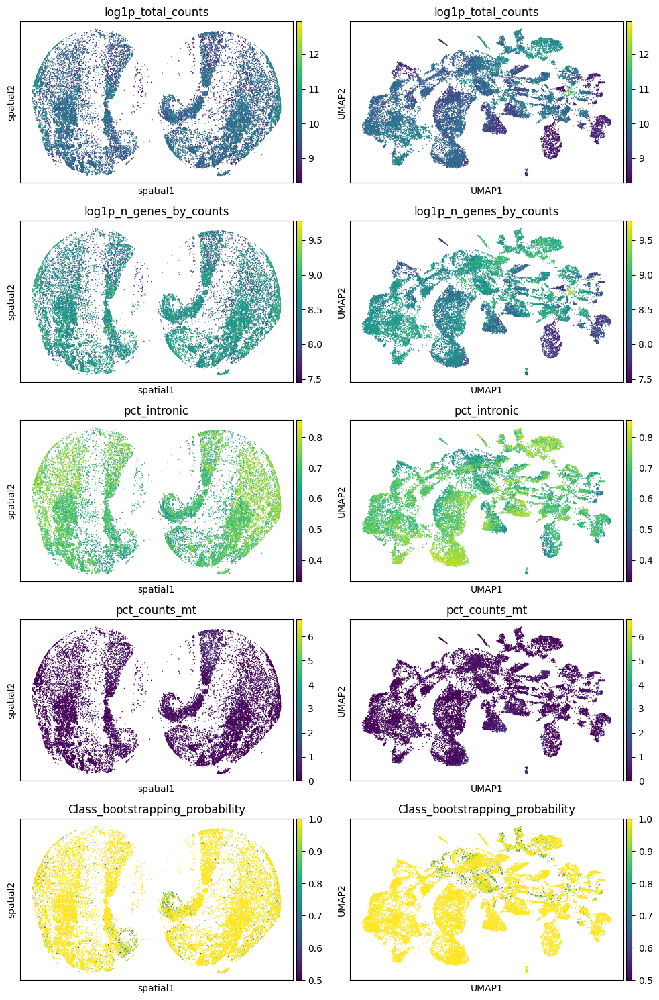

In [16]:
fig, axes = plt.subplots(5, 2, figsize=(10, 15))

for i, res in enumerate(["log1p_total_counts", "log1p_n_genes_by_counts", "pct_intronic", "pct_counts_mt", "Class_bootstrapping_probability"]):
    sc.pl.embedding(adata, basis="spatial", color=res, ax=axes[i,0], show=False, legend_loc=None)
    sc.pl.umap(adata, color=res, ax=axes[i,1], show=False, legend_loc=None)

plt.tight_layout()
plt.show()

# Metrics by Cluster

## Select label resolution

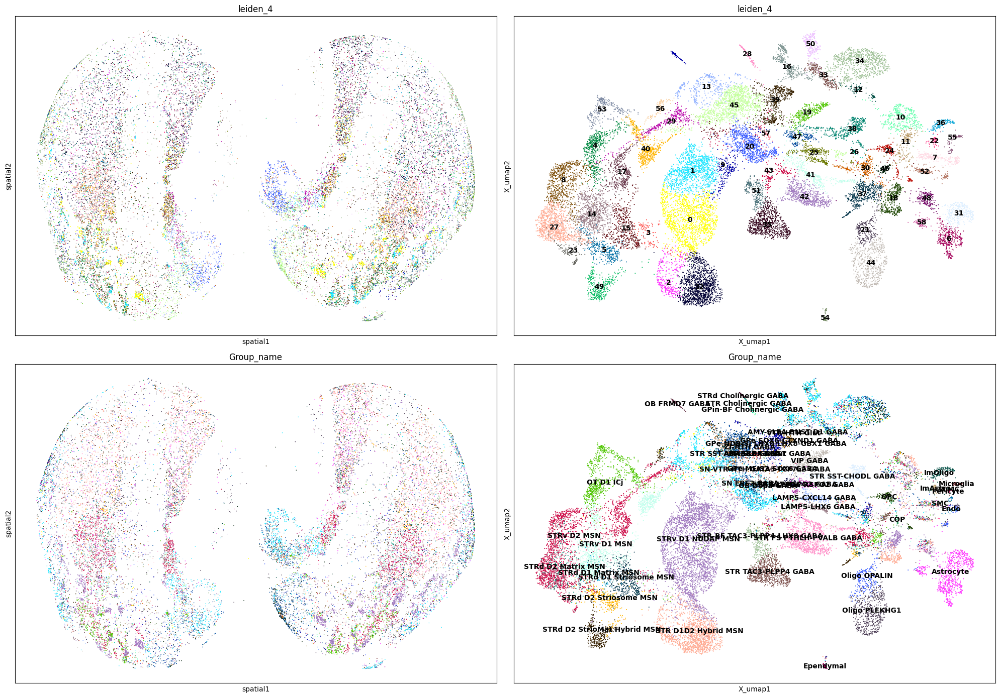

In [17]:
CLUSTER_LEVEL = "leiden_4"
ANNOTATION_LEVEL = "Subclass_name"

fig, axes = plt.subplots(2, 2, figsize=(20, 14))

for i, res in enumerate(["leiden_4", "Group_name"]):
    sc.pl.embedding(adata, basis="spatial", color=res, ax=axes[i,0], show=False, legend_loc=None)
    sc.pl.embedding(adata, basis="X_umap", color=res, ax=axes[i,1], show=False, legend_fontsize=10, size=8, legend_loc="on data",)# legend_loc="lower center")

plt.tight_layout()
plt.show()

## QC metrics by clusters

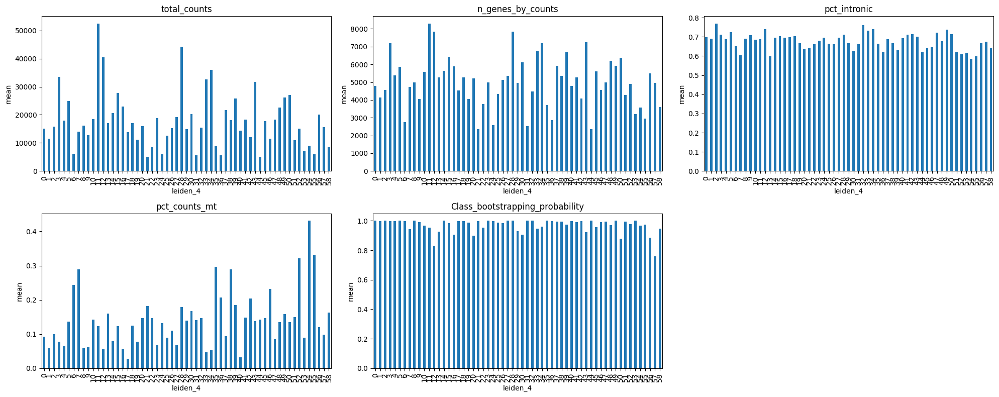

In [19]:
metrics = [
    "total_counts",
    "n_genes_by_counts",
    "pct_intronic",
    "pct_counts_mt",
    "Class_bootstrapping_probability",
]

# compute mean of each metric for each cluster
df_means = (
    adata.obs
    .groupby(CLUSTER_LEVEL, observed=False)[metrics]
    .mean()
    .reset_index()
)


df_means = df_means.set_index(CLUSTER_LEVEL)
# display(df_means)

# Plot
fig, axes = plt.subplots(2, 3, figsize=(20, 8))
axes = axes.flatten()

for ax, col in zip(axes, metrics):
    df_means[col].plot(kind="bar", ax=ax)
    ax.set_title(col)
    ax.set_ylabel("mean")
    ax.tick_params(axis="x")#, rotation=45)

# hide any unused axes
for ax in axes[len(metrics):]:
    ax.set_visible(False)

plt.tight_layout()
plt.show()


# sc.pl.embedding(adata, basis="X_umap", color="leiden_4", legend_loc="on data")


## UMI counts distribution by cluster

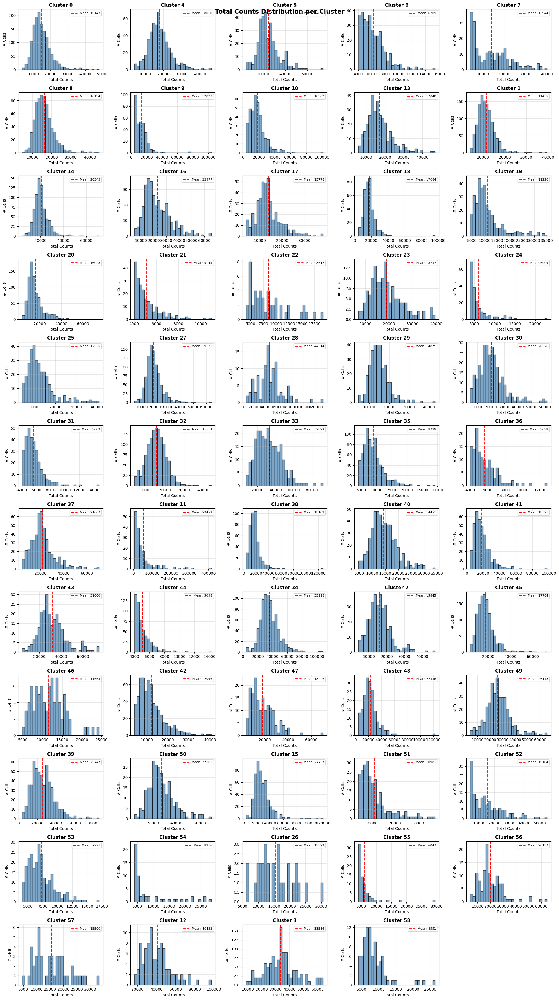

In [20]:
# Get unique clusters
clusters = adata.obs[CLUSTER_LEVEL].unique()

n_clusters = len(clusters)
ncols = 5
nrows = int(np.ceil(n_clusters / ncols))

fig, axes = plt.subplots(nrows, ncols, figsize=(20, 3*nrows))
axes = axes.flatten()

for idx, cluster in enumerate(clusters):
    ax = axes[idx]
    
    # Get data for this cluster
    cluster_data = adata.obs[adata.obs[CLUSTER_LEVEL] == cluster]['total_counts']
    
    # Plot histogram
    ax.hist(cluster_data, bins=30, color='steelblue', alpha=0.7, edgecolor='black')
    ax.set_title(f'Cluster {cluster}', fontweight='bold')
    ax.set_xlabel('Total Counts')
    ax.set_ylabel('# Cells')
    
    # Add mean line
    mean_val = cluster_data.mean()
    ax.axvline(mean_val, color='red', linestyle='--', linewidth=2, 
               label=f'Mean: {mean_val:.0f}')
    
    # Same x-axis for all
    #ax.set_xlim(global_min, global_max)
    ax.legend(fontsize=8)
    ax.grid(alpha=0.3)

# Hide unused subplots
for idx in range(n_clusters, len(axes)):
    axes[idx].axis('off')

plt.suptitle('Total Counts Distribution per Cluster', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()

## Cell Type distribution by cluster

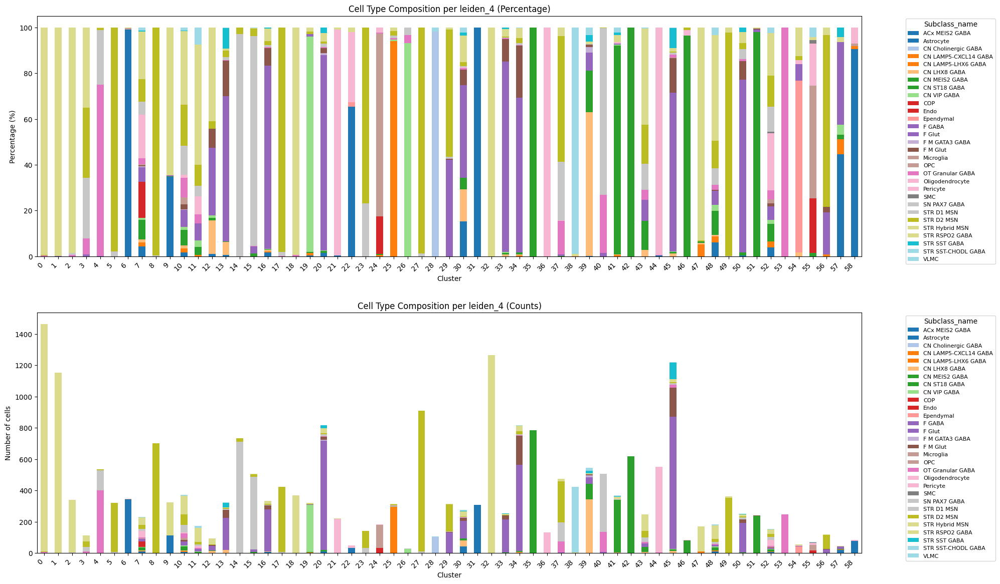


Dominant cell type per cluster:
  Cluster 0: STR Hybrid MSN (1453/1462 cells, 99.4%)
  Cluster 1: STR Hybrid MSN (1151/1153 cells, 99.8%)
  Cluster 2: STR Hybrid MSN (334/339 cells, 98.5%)
  Cluster 3: STR Hybrid MSN (40/114 cells, 35.1%)
  Cluster 4: OT Granular GABA (400/535 cells, 74.8%)
  Cluster 5: STR D2 MSN (315/322 cells, 97.8%)
  Cluster 6: Astrocyte (343/346 cells, 99.1%)
  Cluster 7: Oligodendrocyte (44/231 cells, 19.0%)
  Cluster 8: STR D2 MSN (698/700 cells, 99.7%)
  Cluster 9: STR Hybrid MSN (209/323 cells, 64.7%)
  Cluster 10: STR Hybrid MSN (114/371 cells, 30.7%)
  Cluster 11: STR Hybrid MSN (87/175 cells, 49.7%)
  Cluster 12: STR Hybrid MSN (36/95 cells, 37.9%)
  Cluster 13: F GABA (205/323 cells, 63.5%)
  Cluster 14: STR D1 MSN (711/732 cells, 97.1%)
  Cluster 15: STR D1 MSN (464/506 cells, 91.7%)
  Cluster 16: F GABA (264/334 cells, 79.0%)
  Cluster 17: STR D2 MSN (415/423 cells, 98.1%)
  Cluster 18: STR Hybrid MSN (367/369 cells, 99.5%)
  Cluster 19: CN VIP GABA (3

In [21]:
# Calculate cell type composition for each cluster
cluster_composition = pd.crosstab(
    adata.obs[CLUSTER_LEVEL], 
    adata.obs[ANNOTATION_LEVEL]
)

# Convert to percentages
cluster_composition_pct = cluster_composition.div(cluster_composition.sum(axis=1), axis=0) * 100

# Plot 1: Stacked bar chart (percentage)
fig, axes = plt.subplots(2,1, figsize=(20, 12))

cluster_composition_pct.plot(
    kind='bar', 
    stacked=True, 
    ax=axes[0],
    colormap='tab20'
)
axes[0].set_title(f'Cell Type Composition per {CLUSTER_LEVEL} (Percentage)')
axes[0].set_xlabel('Cluster')
axes[0].set_ylabel('Percentage (%)')
axes[0].legend(title=ANNOTATION_LEVEL, bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=8)
axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=45, ha='right')

# Plot 2: Stacked bar chart (absolute counts)
cluster_composition.plot(
    kind='bar', 
    stacked=True, 
    ax=axes[1],
    colormap='tab20'
)
axes[1].set_title(f'Cell Type Composition per {CLUSTER_LEVEL} (Counts)')
axes[1].set_xlabel('Cluster')
axes[1].set_ylabel('Number of cells')
axes[1].legend(title=ANNOTATION_LEVEL, bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=8)
axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=45, ha='right')

plt.tight_layout()
plt.show()

# Print summary: dominant cell type per cluster
print("\nDominant cell type per cluster:")
for cluster in cluster_composition_pct.index:
    dominant_type = cluster_composition_pct.loc[cluster].idxmax()
    percentage = cluster_composition_pct.loc[cluster, dominant_type]
    count = cluster_composition.loc[cluster, dominant_type]
    total = cluster_composition.loc[cluster].sum()
    print(f"  Cluster {cluster}: {dominant_type} ({count}/{total} cells, {percentage:.1f}%)")

## Cell Type distribution on Umap/spatial

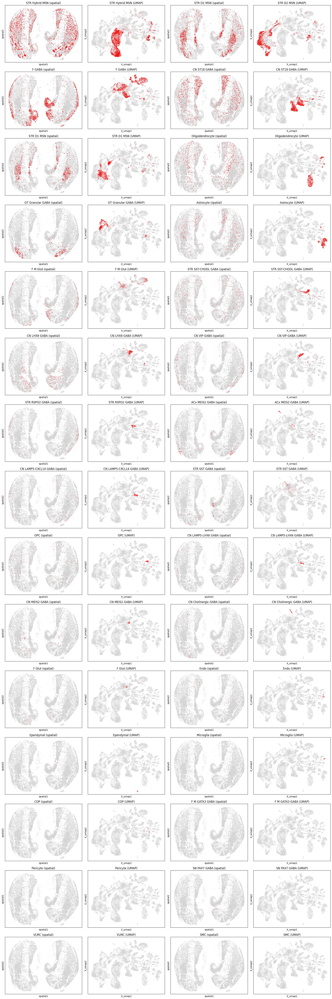

In [23]:
preprocessing.plot_cell_type(adata, ANNOTATION_LEVEL=ANNOTATION_LEVEL)

## Overall cell type distribution

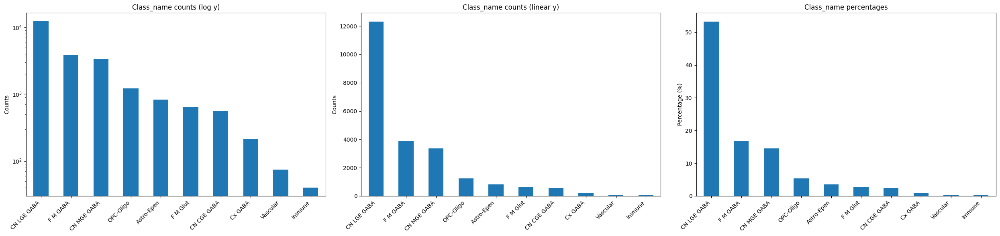

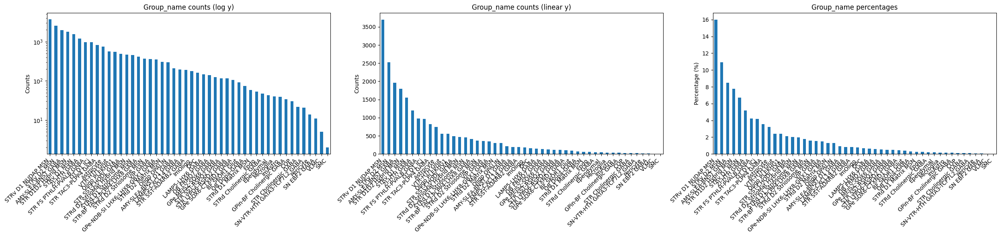

In [29]:
preprocessing.plot_cell_type_distribution(adata, annotation_levels=["Class_name", "Group_name"])

# Remove Doublets clusters

excluding cell clusters that co-express marker genes of distinct cell types (not UMI based approach).

Problem: Homotypic doublets (formed by transcriptionally similar cells) cannot be detected this way

Check if the doublet cluster is positioned between its "parent" clusters in UMAP space


In [25]:
markers = {
    # Non-neuronal cells
    'Astrocyte': ['GFAP', 'AQP4', 'GINS3'],
    
    'Ependymal': ['ZBBX'],
    
    'Endothelial': ['DCN', 'FLT1'],
    
    'Lymphocyte': ['SKAP1', 'THEMIS'],
    
    'Microglia': ['CX3CR1', 'P2RY12', 'C1QA', 'C1QB', 'C1QC'],
    
    'Macrophage': ['CD163', 'CD200R1'],
    
    'Oligodendrocyte': ['MOBP', 'MBP', 'PLP1'],# 'SHROOM4', 'TF'],
    
    'OPC': ['VCAN', 'PDGFRA'],
    
    # Neurons - using ONLY subtype-specific markers (no RBFOX3/SYT1 overlap)
    'Neuron_inhibitory': ['GAD1', 'GAD2', 'SLC32A1'],
    
    'Neuron_excitatory': ['SLC17A6', 'SLC17A7', 'SLC17A8'],
    
    'Neuron_dopaminergic': ['SLC6A3', 'TH'],
    
    'Neuron_cholinergic': ['CHAT'],
    
    'Neuron_serotonergic': ['SLC6A4'],
}

mapping_genes_name_dict = adata.var[["gene_symbol"]].to_dict()["gene_symbol"].copy()
symbol_to_varid = {v.upper(): k for k, v in mapping_genes_name_dict.items() if isinstance(v, str)}
translated_markers = {
    celltype: [symbol_to_varid.get(gene.upper(), None) for gene in genes]
    for celltype, genes in markers.items()
}

display(translated_markers)


{'Astrocyte': ['ENSG00000131095', 'ENSG00000171885', 'ENSG00000181938'],
 'Ependymal': ['ENSG00000169064'],
 'Endothelial': ['ENSG00000011465', 'ENSG00000102755'],
 'Lymphocyte': ['ENSG00000141293', 'ENSG00000172673'],
 'Microglia': ['ENSG00000168329',
  'ENSG00000169313',
  'ENSG00000173372',
  'ENSG00000173369',
  'ENSG00000159189'],
 'Macrophage': ['ENSG00000177575', 'ENSG00000163606'],
 'Oligodendrocyte': ['ENSG00000168314', 'ENSG00000197971', 'ENSG00000123560'],
 'OPC': ['ENSG00000038427', 'ENSG00000134853'],
 'Neuron_inhibitory': ['ENSG00000128683',
  'ENSG00000136750',
  'ENSG00000101438'],
 'Neuron_excitatory': ['ENSG00000091664',
  'ENSG00000104888',
  'ENSG00000179520'],
 'Neuron_dopaminergic': ['ENSG00000142319', 'ENSG00000180176'],
 'Neuron_cholinergic': ['ENSG00000070748'],
 'Neuron_serotonergic': ['ENSG00000108576']}

## Plot single markers expression

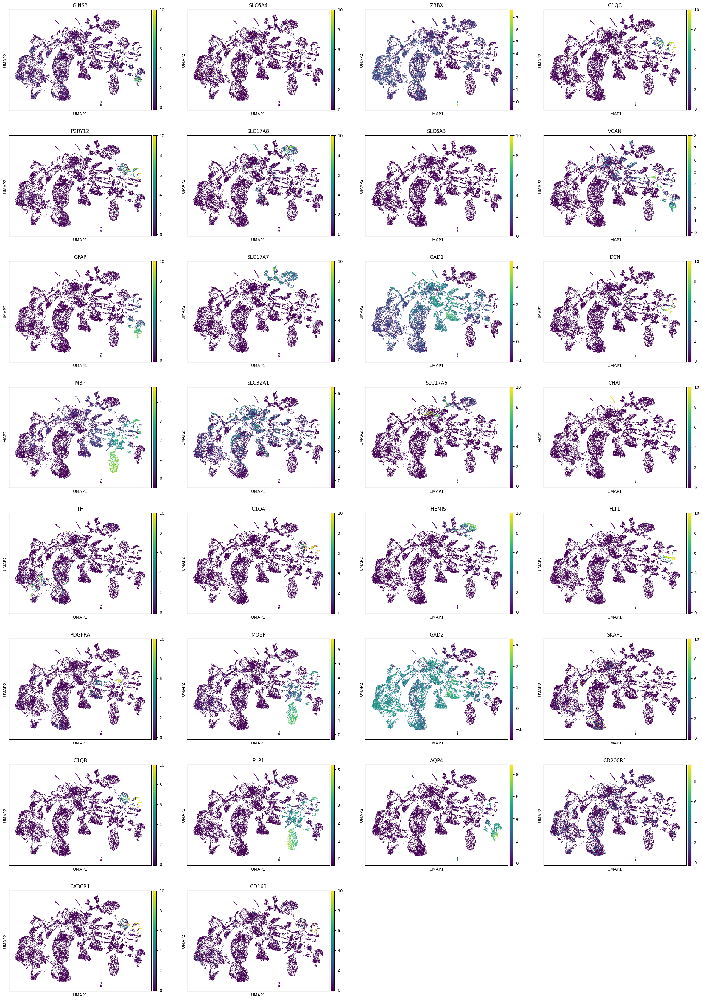

In [26]:
gene_to_plot = set()
for key, item in markers.items():
    gene_to_plot.update(set(item))
    
sc.pl.umap(adata, color=gene_to_plot, cmap='viridis', ncols=4, gene_symbols="gene_symbol")#, vmin=-1, vmax=1)


## Putative Doublets by gene Markers

Find gene makers (DEGs) for each cluster and see if they are ibtersection with makrher genes of a specific cell type.

If they overlap wiht more than 2 cell types they coudl be doublets.

In [27]:
# Find marker genes for each cluster (equivalent to FindAllMarkers)
    # need log normlsied data --< NPY scaled
    # DEG: cluster Vs rest
sc.tl.rank_genes_groups(
    adata, 
    groupby=CLUSTER_LEVEL, 
    method='wilcoxon', 
    reference="rest", 
    corr_method="benjamini-hochberg",
    use_raw=False, 
    layer="log1p_norm", #ATTNETION: NOT scaled data in X
    pts = True, # ATTENTION; % cells expressing gene IN and OUT cluster 
)

/home/gdallagl/myworkdir/XDP/.venv/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:458: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
/home/gdallagl/myworkdir/XDP/.venv/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:460: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
/home/gdallagl/myworkdir/XDP/.venv/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:463: Perform

  0%|          | 0/59 [00:00<?, ?it/s]

{'6': ['Astrocyte', 'OPC'],
 '7': ['Endothelial', 'Oligodendrocyte'],
 '11': ['Microglia', 'Oligodendrocyte'],
 '12': ['Lymphocyte', 'Oligodendrocyte', 'Neuron_excitatory'],
 '22': ['Astrocyte', 'Microglia', 'OPC'],
 '24': ['Oligodendrocyte', 'OPC'],
 '26': ['Oligodendrocyte', 'OPC'],
 '28': ['Neuron_excitatory', 'Neuron_cholinergic'],
 '29': ['Ependymal', 'Neuron_inhibitory'],
 '33': ['Lymphocyte', 'Neuron_excitatory'],
 '34': ['Lymphocyte', 'Neuron_excitatory'],
 '36': ['Microglia', 'Oligodendrocyte'],
 '48': ['Astrocyte', 'OPC'],
 '50': ['OPC', 'Neuron_excitatory'],
 '52': ['Astrocyte', 'Endothelial', 'Oligodendrocyte'],
 '54': ['Astrocyte', 'Ependymal', 'OPC'],
 '55': ['Microglia', 'Oligodendrocyte'],
 '58': ['Astrocyte', 'Oligodendrocyte', 'OPC']}

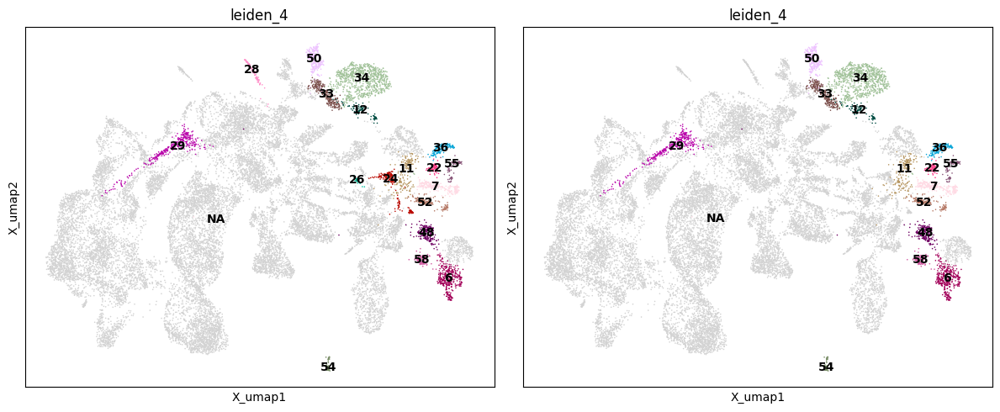

In [31]:
# Get top genes as DataFrame
top_n = 300
doublet_clusters_markers = {}

for cluster in tqdm(adata.obs[CLUSTER_LEVEL].cat.categories):

    # Get top genes for this cluster
    df = sc.get.rank_genes_groups_df(adata, group=cluster) # sorted by score

    df = df[
        (df.pvals_adj < 0.05) &
        (df.logfoldchanges > 1) &
        (df.scores > 0) &
        (df['pct_nz_group'] > 0.25) &  # only test genes that are detected in a minimum fraction  IN cluster
        (df['pct_nz_reference'] < 0.50) & # only test genes NOT expressed outside
        ((df['pct_nz_group'] - df['pct_nz_reference']) > 0.10) # Gene must be >10% more frequent in cluster than outside  
    ] 


    #display(df)
    top_genes = set(df.head(top_n)['names'].tolist())
    #print(top_genes)

    # check if these top genes overlpa wiht one of the gene list of a specific cell type
    cell_types_found = {}
    for cell_type, cell_type_markers in translated_markers.items(): # ATTENTION: gene name
        overlap = top_genes & set(cell_type_markers)
        if len(overlap) != 0:
            cell_types_found[cell_type] = list(overlap)

    if len(cell_types_found.keys()) >= 2:
        doublet_clusters_markers[cluster] = list(cell_types_found.keys())


display(doublet_clusters_markers)


fig, axes = plt.subplots(1, 2, figsize=(12, 5))
for ax, g in zip(axes, [list(doublet_clusters_markers.keys()), 
                    ['6', '7', '11', '12', '22', '29', '33', '34', '36', '48', '50', '52', '54', '55', '58']]# clusters with very differt cell types
                    ): 
    sc.pl.embedding(adata, basis="X_umap", color="leiden_4", legend_loc="on data",
                    groups=g, ax=ax, show=False, return_fig=False)
plt.tight_layout(); plt.show()




## Putative Doublets by Module score and Entropy

FOr each cell tyope marker genes lists, calculate the relative module socre (for each cell).

Calculate mean module score for each cluster for each module.

Claulte Entropy of these menas per cluster.

CLusters wiht high entropy (mix of modules) are doublets.

  0%|          | 0/13 [00:00<?, ?it/s]

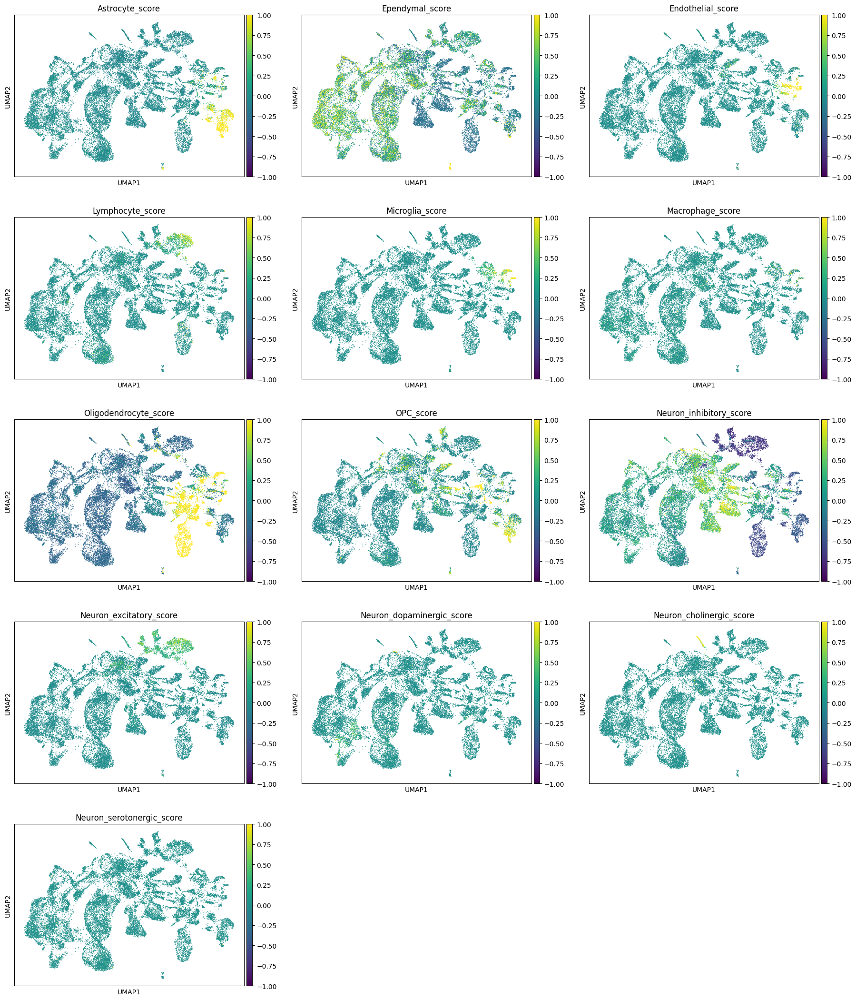

In [32]:
# DOUBLETS USING MODULE SCORE

for cell_type, genes in tqdm(translated_markers.items()):
    # Only use genes that exist in your data
    #genes_available = [g for g in genes if g in adata.var.gene_symbol.to_list()]
    
    if len(genes) > 0:
        #print(f"  {cell_type}: {len(genes)} markers")
        sc.tl.score_genes(adata, genes, score_name=f'{cell_type}_score', use_raw=False, layer="log1p_norm") # normalised scores (not scaled)
    else:
        print(f"  ⚠ {cell_type}: No markers found!")

# plot umaps
score_cols = [f'{ct}_score' for ct in markers.keys() if f'{ct}_score' in adata.obs]
sc.pl.umap(adata, color=score_cols, cmap='viridis', ncols=3, vmin=-1, vmax=1)


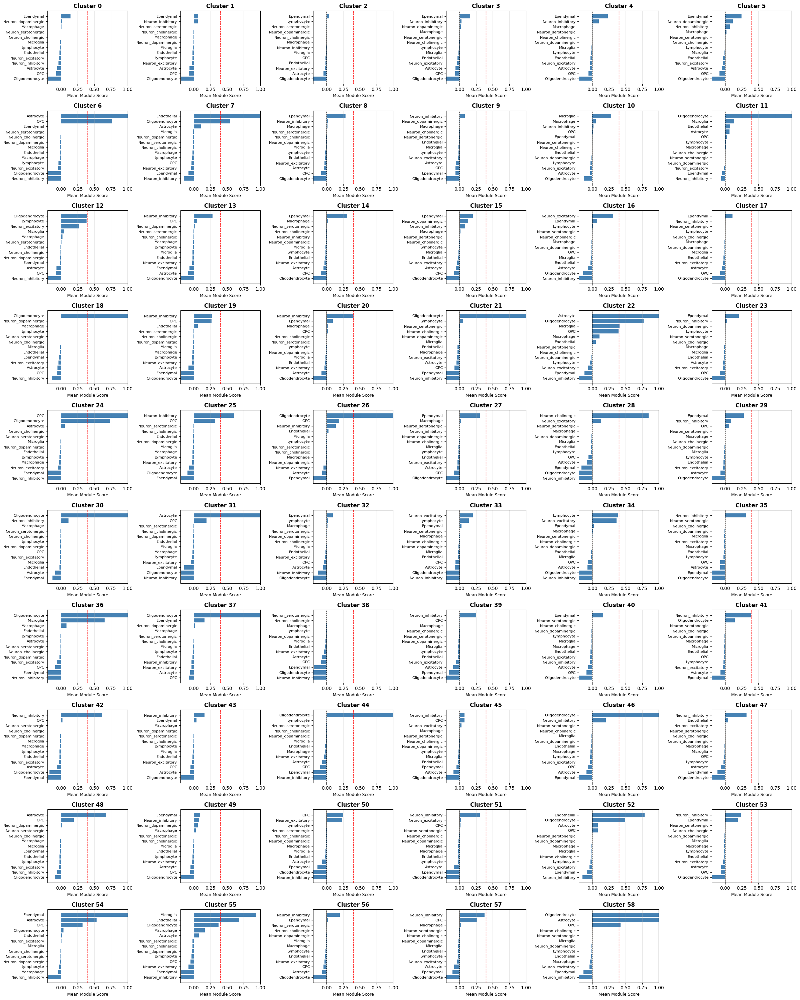

In [33]:
# plot moduels per cluster
# Get mean scores per cluster
cluster_scores = adata.obs.groupby(CLUSTER_LEVEL, observed=False)[score_cols].mean()

# Clean column names
cluster_scores.columns = [c.replace('_score', '') for c in cluster_scores.columns]

# Simple barplot - one per cluster
n_clusters = len(cluster_scores)
ncols = 6
nrows = int(np.ceil(n_clusters / ncols))

fig, axes = plt.subplots(nrows, ncols, figsize=(4*ncols, 3*nrows))
axes = axes.flatten() if n_clusters > 1 else [axes]

for idx, (cluster, row) in enumerate(cluster_scores.iterrows()):
    ax = axes[idx]
    
    # Sort values for easier reading
    sorted_data = row.sort_values(ascending=True)
    
    # Plot
    ax.barh(range(len(sorted_data)), sorted_data.values, color='steelblue')
    ax.set_yticks(range(len(sorted_data)))
    ax.set_yticklabels(sorted_data.index, fontsize=8)
    ax.set_xlabel('Mean Module Score', fontsize=9)
    ax.set_title(f'Cluster {cluster}', fontweight='bold')
    ax.axvline(0, color='black', linestyle='--', linewidth=0.8)
    ax.grid(axis='x', alpha=0.3)
    ax.set_xlim((-0.2, 1))
    ax.axvline(0.4, linestyle='--', linewidth=1, color="red")

# Hide empty subplots
for idx in range(n_clusters, len(axes)):
    axes[idx].axis('off')

plt.tight_layout()
plt.show()

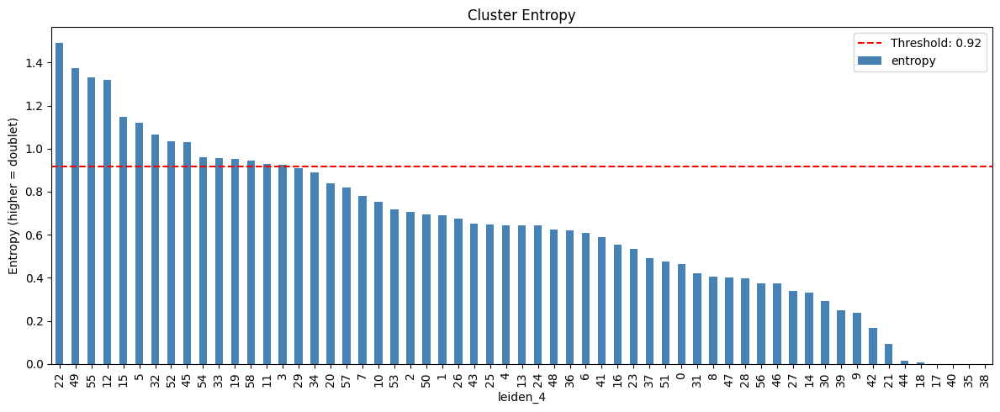

Entropy-based doublet clusters:


{'3': ['Ependymal', 'Neuron_inhibitory', 'Neuron_dopaminergic'],
 '5': ['Ependymal', 'Neuron_dopaminergic', 'Neuron_inhibitory'],
 '11': ['Oligodendrocyte', 'Microglia', 'Endothelial'],
 '12': ['Oligodendrocyte', 'Lymphocyte', 'Neuron_excitatory'],
 '15': ['Ependymal', 'Neuron_dopaminergic', 'Neuron_inhibitory'],
 '19': ['Neuron_inhibitory', 'OPC', 'Endothelial'],
 '22': ['Astrocyte', 'Oligodendrocyte', 'Microglia'],
 '32': ['Ependymal', 'Lymphocyte', 'Macrophage'],
 '33': ['Neuron_excitatory', 'Lymphocyte', 'Ependymal'],
 '45': ['Neuron_inhibitory', 'OPC', 'Neuron_excitatory'],
 '49': ['Ependymal', 'Neuron_inhibitory', 'Neuron_dopaminergic'],
 '52': ['Endothelial', 'Oligodendrocyte', 'Astrocyte'],
 '54': ['Ependymal', 'Astrocyte', 'OPC'],
 '55': ['Microglia', 'Endothelial', 'Oligodendrocyte'],
 '58': ['Oligodendrocyte', 'Astrocyte', 'OPC']}

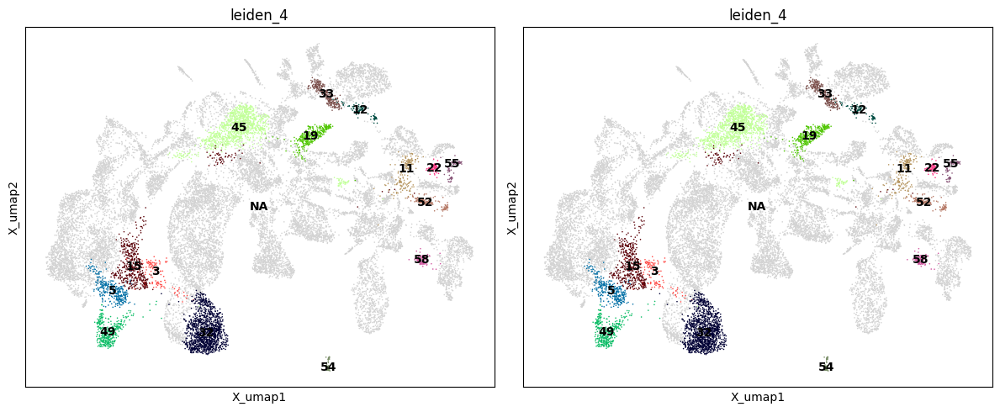

In [35]:
from scipy.stats import entropy

# Calculate entropy for each cluster (higher = more mixed)
cluster_scores_entropy = cluster_scores.copy()
cluster_scores_entropy['entropy'] = cluster_scores.apply(
    lambda x: entropy(x[x > 0] / x[x > 0].sum()) if (x > 0).sum() > 1 else 0,  # clauclte onyl for vlaues bogger than 0
    axis=1
)

# Flag top 25% as potential doublets
threshold = cluster_scores_entropy['entropy'].quantile(0.75)
high_entropy_clusters = cluster_scores_entropy[cluster_scores_entropy['entropy'] > threshold]

# Plot
cluster_scores_entropy['entropy'].sort_values(ascending=False).plot(
    kind='bar', figsize=(12, 5), color='steelblue', title='Cluster Entropy'
)
plt.axhline(threshold, color='red', linestyle='--', label=f'Threshold: {threshold:.2f}')
plt.ylabel('Entropy (higher = doublet)')
plt.legend()
plt.tight_layout()
plt.show()

# Create doublet dictionary: cluster -> cell types with high scores
doublet_clusters_entropy = {}
for cluster in high_entropy_clusters.index:
    scores = cluster_scores_entropy.loc[cluster].drop('entropy')
    # Get cell types with scores > 0.3
    threshold = scores.quantile(0.75) 
    active_types = scores[scores > threshold].sort_values(ascending=False)
    if len(active_types) >= 2:
        doublet_clusters_entropy[cluster] = active_types.index.tolist()

# Display results
print("Entropy-based doublet clusters:")
display(doublet_clusters_entropy)

# Plot
fig, axes = plt.subplots(1, 2, figsize=(12, 5))
for ax, clusters in zip(axes, [list(doublet_clusters_entropy.keys()), 
                               ['3', '5', '11', '12', '15', '19', '22', '32', '33', '45', '49', '52', '54', '55', '58']]):
    sc.pl.embedding(adata, basis="X_umap", color="leiden_4", legend_loc="on data",
                    groups=clusters, ax=ax, show=False)
plt.tight_layout()
plt.show()

## Plot Oligos Marker

Difficult to distinguish evolving Oligos from doubelts

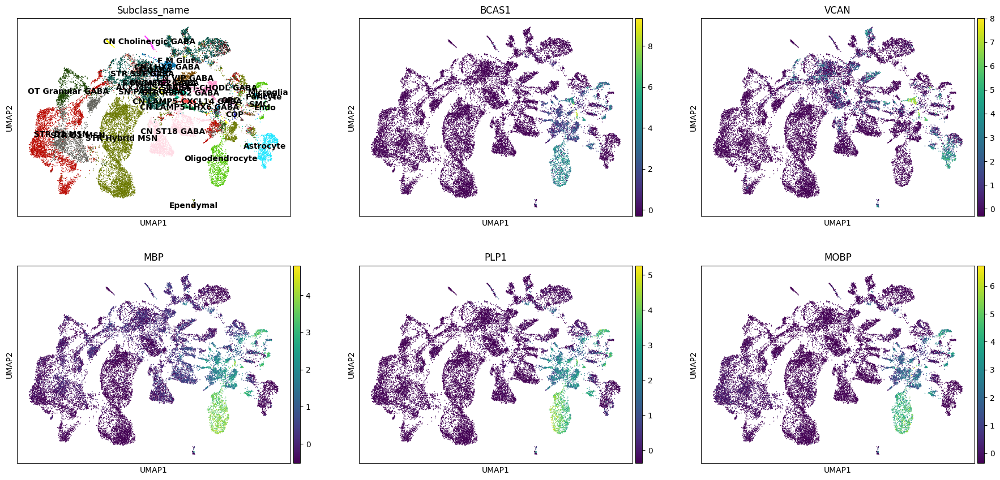

In [36]:
# Check if they're differentiating OPCs (real) or doublets (artifact)
#(Oligo + OPC)
# REAL BIOLOGY (good) ✓
# OPC differentiating into Oligodendrocyte
# → Transition state, should KEEP!
#  BCAS1 expression (differentiation marker) --> BCAS1 high → Real differentiating cells → KEEP ✓
sc.pl.umap(adata, color=['Subclass_name', 
                         'BCAS1',  # differentiationg
                         'VCAN', # OPC
                         'MBP', 'PLP1', 'MOBP' # Mature Oligo
                         ], gene_symbols="gene_symbol", ncols=3, legend_loc="on data")

## Plot Neun markers

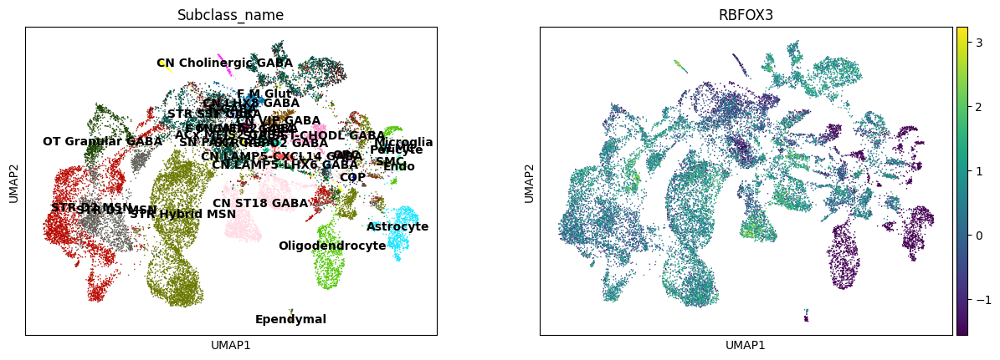

In [37]:
sc.pl.umap(adata, color=['Subclass_name', 
                         'RBFOX3', 
                         ], gene_symbols="gene_symbol", ncols=3, legend_loc="on data")

## Call Doublets by overlapping methods

{'11': [['Oligodendrocyte', 'Microglia', 'Endothelial'],
  ['Microglia', 'Oligodendrocyte']],
 '12': [['Oligodendrocyte', 'Lymphocyte', 'Neuron_excitatory'],
  ['Lymphocyte', 'Oligodendrocyte', 'Neuron_excitatory']],
 '22': [['Astrocyte', 'Oligodendrocyte', 'Microglia'],
  ['Astrocyte', 'Microglia', 'OPC']],
 '33': [['Neuron_excitatory', 'Lymphocyte', 'Ependymal'],
  ['Lymphocyte', 'Neuron_excitatory']],
 '52': [['Endothelial', 'Oligodendrocyte', 'Astrocyte'],
  ['Astrocyte', 'Endothelial', 'Oligodendrocyte']],
 '54': [['Ependymal', 'Astrocyte', 'OPC'], ['Astrocyte', 'Ependymal', 'OPC']],
 '55': [['Microglia', 'Endothelial', 'Oligodendrocyte'],
  ['Microglia', 'Oligodendrocyte']],
 '58': [['Oligodendrocyte', 'Astrocyte', 'OPC'],
  ['Astrocyte', 'Oligodendrocyte', 'OPC']]}

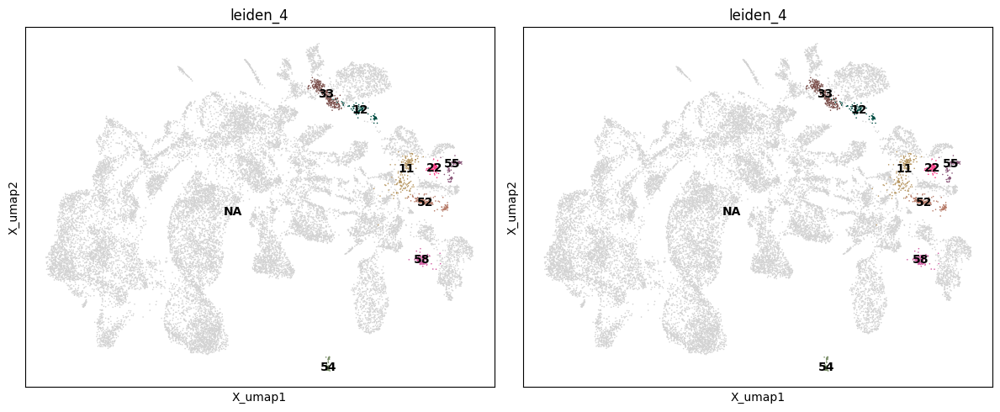

In [39]:
common_keys = sorted(doublet_clusters_entropy.keys() & doublet_clusters_markers.keys())

final_dt = {
    k: [doublet_clusters_entropy[k], doublet_clusters_markers[k]]
    for k in common_keys
}

display(final_dt)

fig, axes = plt.subplots(1, 2, figsize=(12, 5))
for ax, clusters in zip(axes, [list(final_dt.keys()), 
                               ['11', '12', '22', '33', '52', '54', '55', '58']]):
    sc.pl.embedding(adata, basis="X_umap", color="leiden_4", legend_loc="on data",
                    groups=clusters, ax=ax, show=False)
plt.tight_layout()
plt.show()

## Filter

In [40]:
DOUBLET_CLUSTERS = ['11', '12', '22', '33', '52', '54', '55', '58']
print(adata)
adata = adata[~adata.obs[CLUSTER_LEVEL].isin(DOUBLET_CLUSTERS)]
print(adata)

adata.write(f'/home/gdallagl/myworkdir/XDP/data/XDP/disease/240805_SL-EXD_0328_B22FKKYLT4/SI-TT-{LIBRARY}/adata/doublets_filtered_adata.h5ad')

AnnData object with n_obs × n_vars = 23125 × 33833
    obs: 'x', 'y', 'pct_intronic', 'is_cell', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Neighborhood_aggregate_probability', 'Neighborhood_correlation_coefficient', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Class_aggregate_probability', 'Class_correlation_coefficient', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Subclass_aggregate_probability', 'Subclass_correlation_coefficient', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Group_aggregate_probability', 'Group_correlation_coefficient', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'Cluster_aggregate_probability', 'Cluster_correlation_coefficient', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_cou

# Reprocess Clean Data

/home/gdallagl/myworkdir/XDP/.venv/lib/python3.11/site-packages/anndata/_core/anndata.py:629: FutureWarning: You are attempting to set `X` to a matrix on a view which has non-unique indices. The resulting `adata.X` will likely not equal the value to which you set it. To avoid this potential issue, please make a copy of the data first. In the future, this operation will throw an error.
  warnings.warn(msg, FutureWarning, stacklevel=1)
/tmp/ipykernel_512153/1228630979.py:2: UserWarning: Trying to set a dense array with a sparse array on a view.Densifying the sparse array.This may incur excessive memory usage
  adata.X = adata.layers["counts"]
/tmp/ipykernel_512153/1228630979.py:2: ImplicitModificationWarning: Modifying `X` on a view results in data being overridden
  adata.X = adata.layers["counts"]


Normalizing...


/home/gdallagl/myworkdir/XDP/.venv/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:269: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Findingn HCGs...


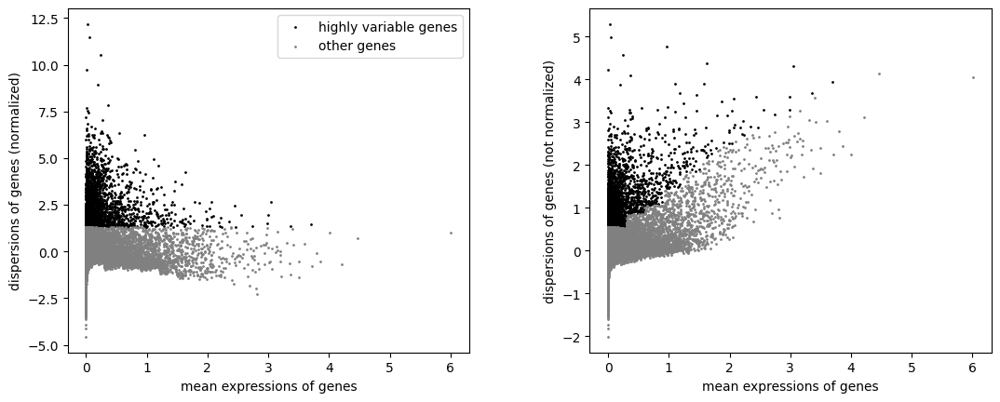

Scaling...
Calculating PCA...


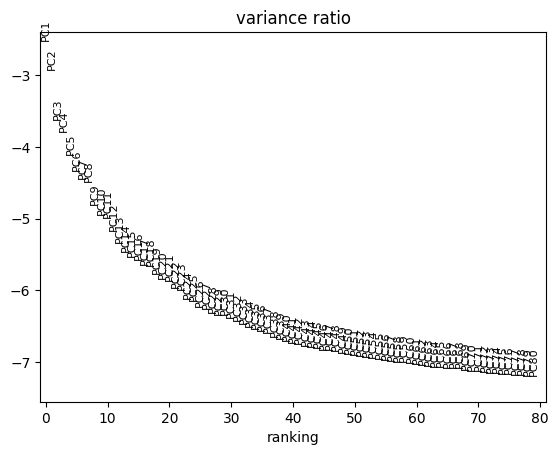

Calculating neightbors...
Calculating Umap...
Clutering...


In [41]:
# ATTENTION: bring bacj count
adata.X = adata.layers["counts"]

preprocessing.preprocess(adata, n_pcs_elbow=30, n_hvg=3000)

adata.write(f'/home/gdallagl/myworkdir/XDP/data/XDP/disease/240805_SL-EXD_0328_B22FKKYLT4/SI-TT-{LIBRARY}/adata/reprocessed_filtered_adata.h5ad')
del(adata)

In [42]:
adata = sc.read_h5ad(f'/home/gdallagl/myworkdir/XDP/data/XDP/disease/240805_SL-EXD_0328_B22FKKYLT4/SI-TT-{LIBRARY}/adata/reprocessed_filtered_adata.h5ad')

# Plots

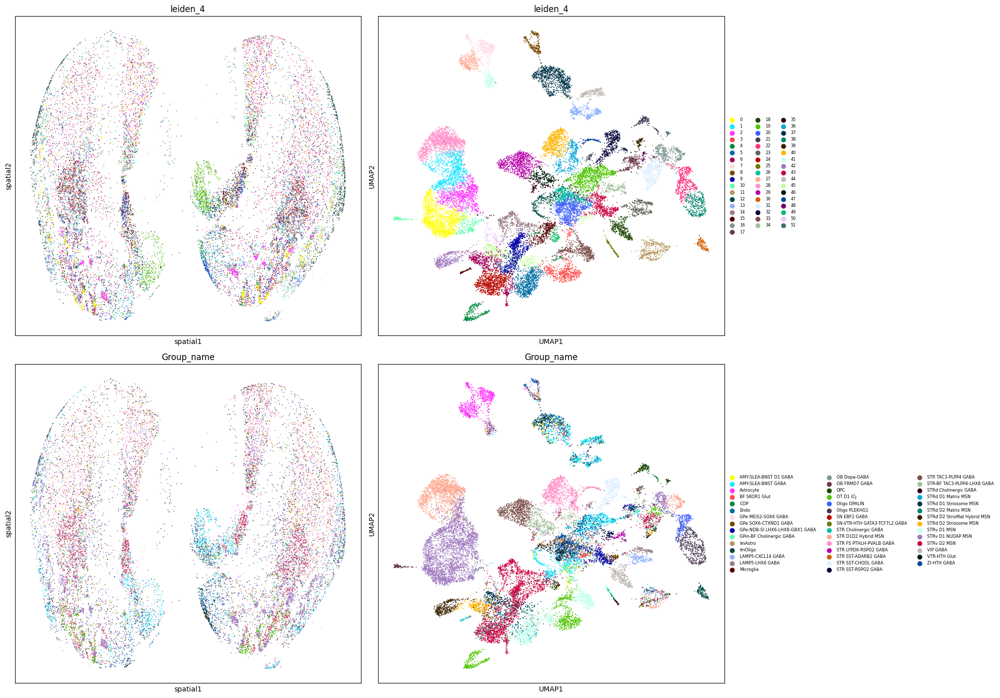

In [43]:
fig, axes = plt.subplots(2, 2, figsize=(20, 14))

for i, res in enumerate(["leiden_4", "Group_name"]):
    sc.pl.embedding(adata, basis="spatial", color=res, ax=axes[i,0], show=False, legend_loc=None)
    sc.pl.umap(adata, color=res, ax=axes[i,1], show=False, legend_fontsize=6, size=8)# legend_loc="lower center")

plt.tight_layout()
plt.show()

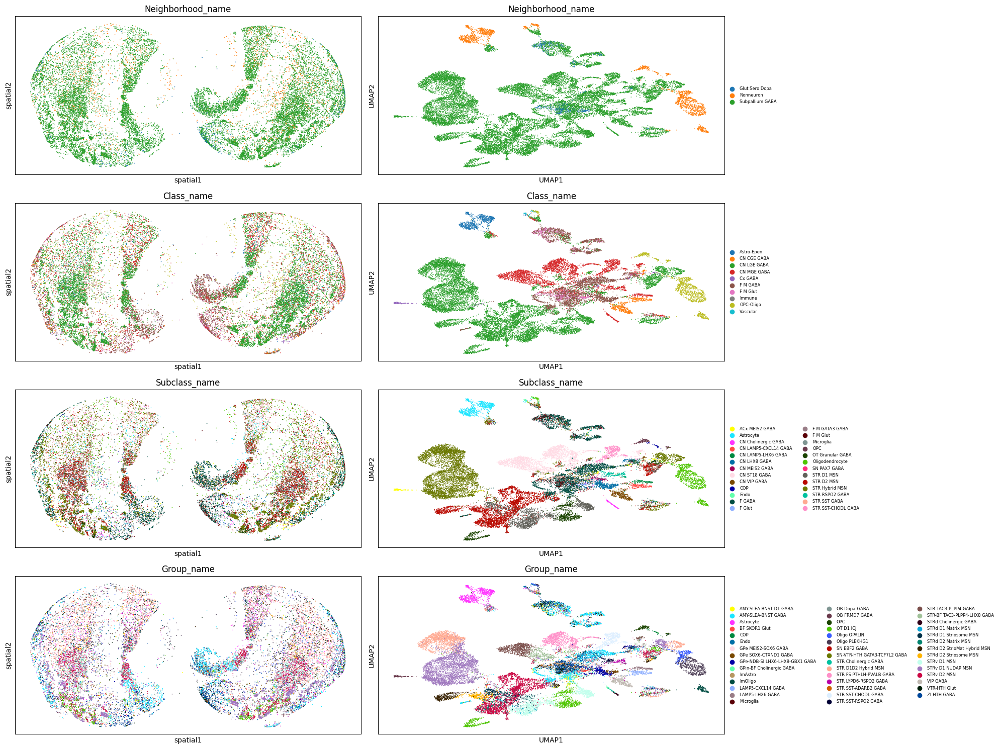

In [44]:
fig, axes = plt.subplots(4, 2, figsize=(20, 15))

for i, res in enumerate(["Neighborhood_name", "Class_name", "Subclass_name", "Group_name"]):
    sc.pl.embedding(adata, basis="spatial", color=res, ax=axes[i,0], show=False, legend_loc=None)
    sc.pl.umap(adata, color=res, ax=axes[i,1], show=False, legend_fontsize=6)# legend_loc="lower center")

plt.tight_layout()
plt.show()

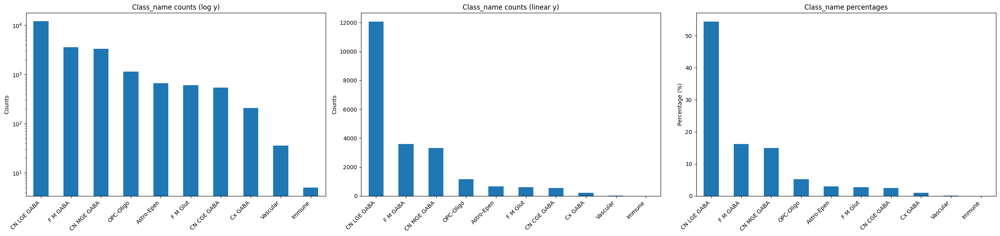

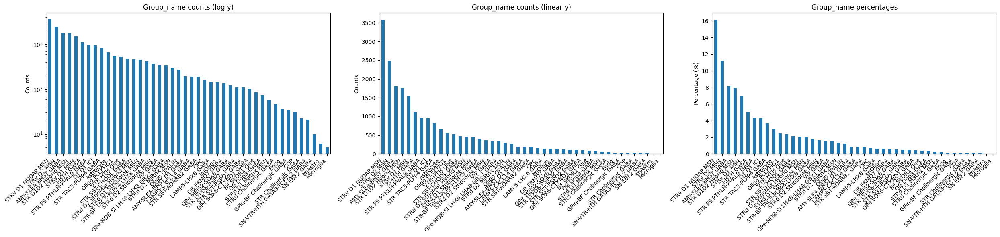

In [45]:
preprocessing.plot_cell_type_distribution(adata, annotation_levels=["Class_name", "Group_name"])

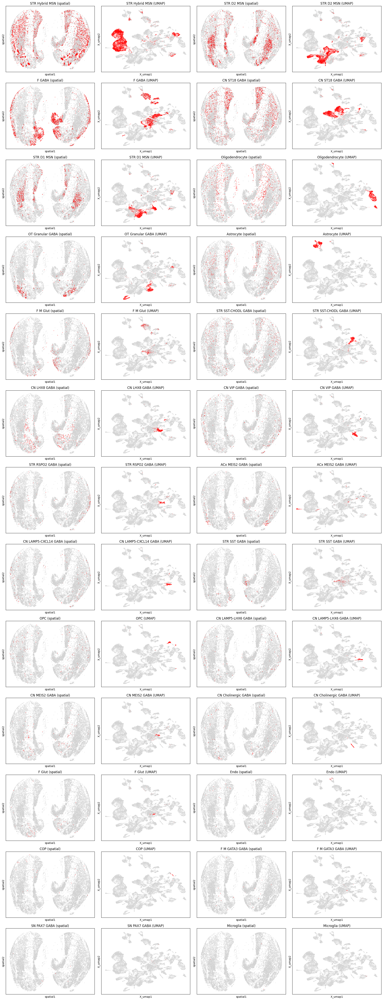

In [46]:
preprocessing.plot_cell_type(adata, ANNOTATION_LEVEL=ANNOTATION_LEVEL)

In [ ]:
striatum_specific = [
    # Medium Spiny Neurons (MSNs) - THE striatal signature cells
    'STRv D1 NUDAP MSN',
    'STRv D2 MSN',
    'STR D1D2 Hybrid MSN',
    'STRv D1 MSN',
    'STRd D1 Striosome MSN',
    'STRd D2 StrioMat Hybrid MSN',
    'STRd D2 Matrix MSN',
    'STRd D2 Striosome MSN',
    'STRd D1 Matrix MSN',
    
    # Striatal interneurons (specific subtypes)
    'STR FS PTHLH-PVALB GABA',  # Fast-spiking interneurons
    'STR TAC3-PLPP4 GABA',
    'STR SST-CHODL GABA',        # Somatostatin interneurons
    'STR-BF TAC3-PLPP4-LHX8 GABA',
    'STR SST-ADARB2 GABA',
    'STR SST-RSPO2 GABA',
    'STR LYPD6-RSPO2 GABA',
    'STR Cholinergic GABA',      # Cholinergic interneurons (TANs)
    'STRd Cholinergic GABA',
    
    # Globus Pallidus (part of striatal system)
    'GPe-NDB-SI LHX6-LHX8-GBX1 GABA',
    'GPe SOX6-CTXND1 GABA',
    'GPe MEIS2-SOX6 GABA',
    'GPin-BF Cholinergic GABA',
]

fig, axes = plt.subplots(1, 2, figsize=(15, 5))

for i, res in enumerate(["Group_name"]):
    sc.pl.embedding(adata, basis="spatial", color=res, ax=axes[0], show=False, legend_loc=None, groups=striatum_specific, size=8)
    sc.pl.umap(adata, color=res, ax=axes[1], show=False, legend_fontsize=6, size=8, groups=striatum_specific)

plt.tight_layout()
plt.show()